# osmnx_2021-04-21-US-MTV-1

In [77]:
import os
import pandas as pd
import numpy as np
import ipynb_path
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn2_circles
import seaborn as sns
import plotly
import plotly.express as px
%matplotlib inline
pd.set_option('display.max_rows', 200)

In [78]:
target = '2021-04-21-US-MTV-1'

In [79]:
def visualize_trafic(df, center, zoom=9):
    fig = px.scatter_mapbox(df,
                            
                            # Here, plotly gets, (x,y) coordinates
                            lat="latDeg",
                            lon="lngDeg",
                            
                            #Here, plotly detects color of series
                            color="phoneName",
                            labels="phoneName",
                            
                            zoom=zoom,
                            center=center,
                            height=1000,
                            width=2000)
    fig.update_layout(mapbox_style='stamen-terrain')
    fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
    fig.update_layout(title_text="GPS trafic")
    fig.show()

In [80]:
def visualize_collection(df, collection):
    target_df = df[df['collectionName']==collection].copy()
    lat_center = target_df['latDeg'].mean()
    lng_center = target_df['lngDeg'].mean()
    center = {"lat":lat_center, "lon":lng_center}
    
    visualize_trafic(target_df, center)

In [81]:
def calc_haversine(lat1, lon1, lat2, lon2):
    """Calculates the great circle distance between two points
    on the earth. Inputs are array-like and specified in decimal degrees.
    """
    RADIUS = 6_367_000
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = np.sin(dlat/2)**2 + \
        np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    dist = 2 * RADIUS * np.arcsin(a**0.5)
    return dist

In [82]:
# directory setting
INPUT = '../input/google-smartphone-decimeter-challenge'

In [83]:
# reading data
base_train = pd.read_csv(INPUT + '/' + 'baseline_locations_train.csv')
base_test = pd.read_csv(INPUT + '/' + 'baseline_locations_test.csv')
sample_sub = pd.read_csv(INPUT + '/' + 'sample_submission.csv')
ground_truth = pd.read_csv(INPUT + '/prep/ground_truth_train.csv')

In [84]:
base_train['phone'] = base_train['collectionName'] + '_' + base_train['phoneName']
ground_truth['phone'] = ground_truth['collectionName'] + '_' + ground_truth['phoneName']

In [85]:
test = base_test[base_test['collectionName']==target].copy()

In [86]:
def remove_based_on_gt(target_df, target_gt, th):
    for idx in target_df.index:
        lat = target_df.at[idx, 'latDeg']
        lng = target_df.at[idx, 'lngDeg']
        s = target_df.at[idx, 'millisSinceGpsEpoch']
        
        if np.isnan(lat):
            continue
        else:
            target_gt['latDeg_pred'] = lat
            target_gt['lngDeg_pred'] = lng
            target_gt['dist'] = calc_haversine(target_gt['latDeg'], target_gt['lngDeg'], target_gt['latDeg_pred'], target_gt['lngDeg_pred'])
            closest_dist = target_gt['dist'].min()
            if closest_dist > th:
                target_df.at[idx, 'latDeg'] = np.nan
                target_df.at[idx, 'lngDeg'] = np.nan
    return target_df

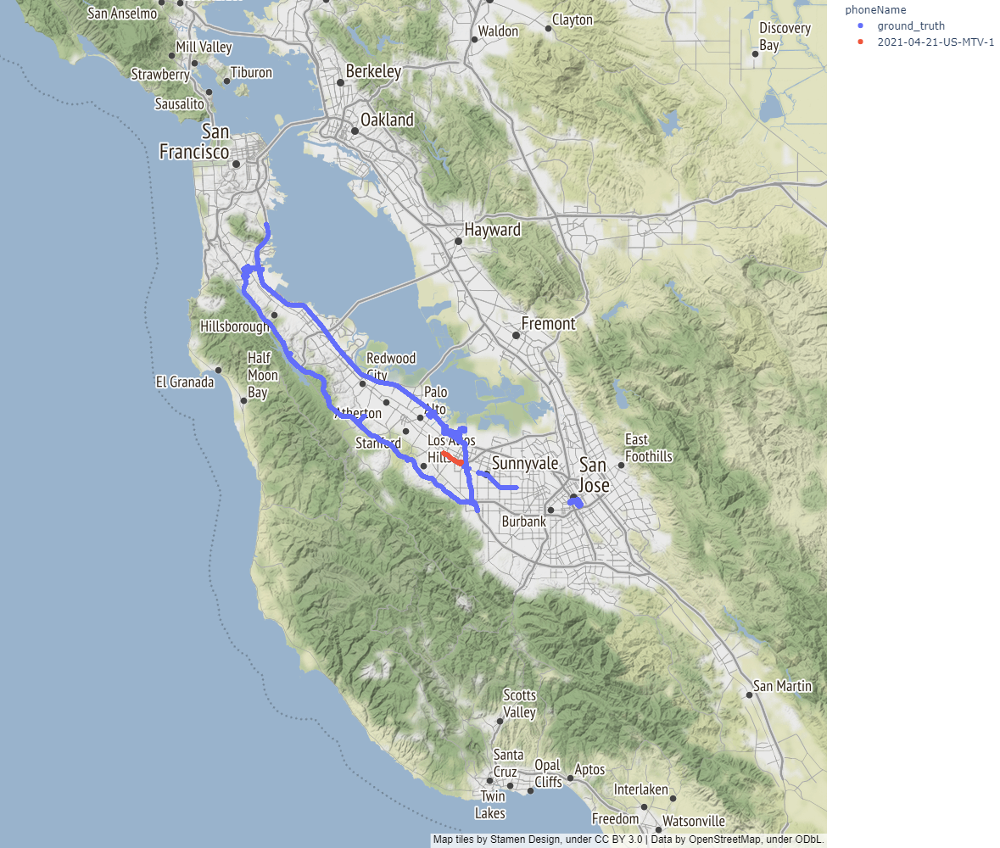

In [87]:
tmp1 = ground_truth.copy()
tmp1['phoneName'] = 'ground_truth'
tmp2 = test.copy()
tmp2['phoneName'] = target
tmp = pd.concat([tmp1, tmp2])
tmp['collectionName'] = 'all'
visualize_collection(tmp, 'all')

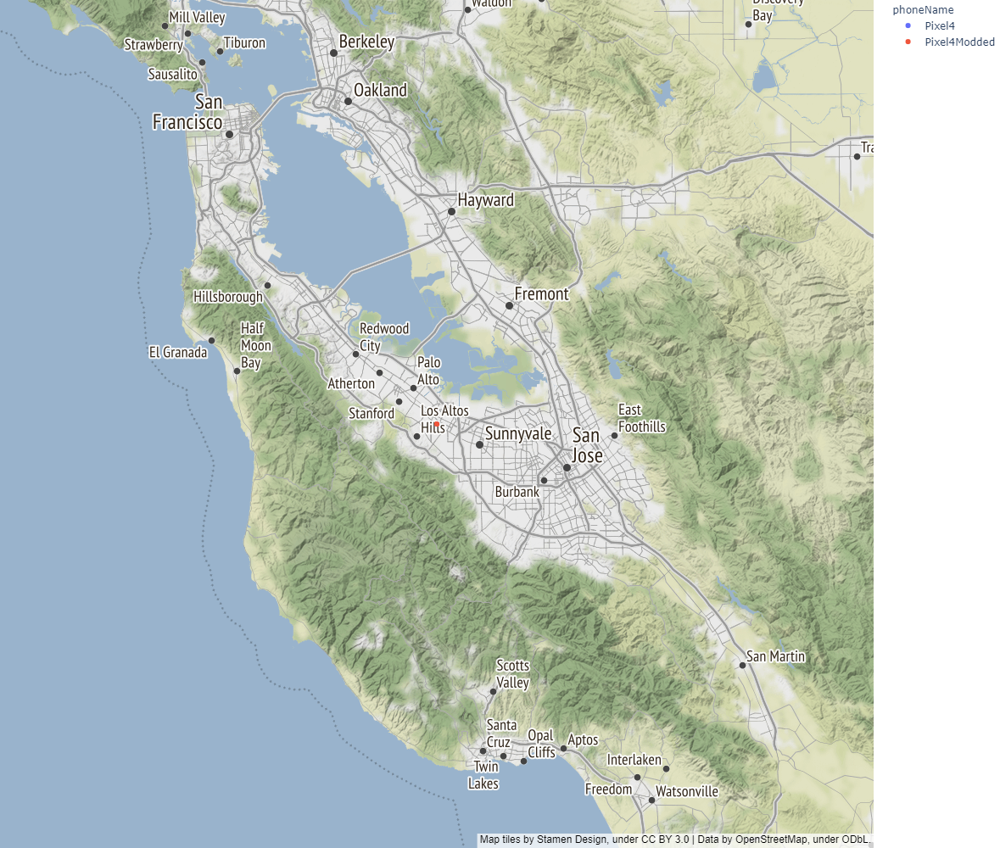

In [117]:
rog = test.copy()
rog = remove_based_on_gt(rog, ground_truth, 30)
idx = rog[rog['latDeg'].isnull()].index
rog_test = test.loc[idx]
visualize_collection(rog_test, target)

In [90]:
from shapely.geometry import Point
import osmnx as ox
import momepy
import geopandas as gpd

In [118]:
# change pd.DataFrame -> gpd.GeoDataFrame
test["geometry"] = [Point(p) for p in test[["lngDeg", "latDeg"]].to_numpy()]
test_gdf = gpd.GeoDataFrame(test, geometry=test["geometry"])

rog_test["geometry"] = [Point(p) for p in rog_test[["lngDeg", "latDeg"]].to_numpy()]
rog_test_gdf = gpd.GeoDataFrame(rog_test, geometry=rog_test["geometry"])

In [146]:
# get road data from open street map by osmnx
offset = (0.1**3)
bbox = rog_test_gdf.bounds + [-offset, -offset, offset, offset]
east = bbox["minx"].min()
west = bbox["maxx"].max()
south = bbox["miny"].min()
north = bbox["maxy"].max()
G = ox.graph.graph_from_bbox(north, south, east, west, network_type='drive')

In [147]:
ox.folium.plot_graph_folium(G)

In [148]:
nodes, edges = momepy.nx_to_gdf(G)

/opt/conda/lib/python3.7/site-packages/momepy/utils.py:418: UserWarning:

Approach is not set. Defaulting to 'primal'.



<AxesSubplot:>

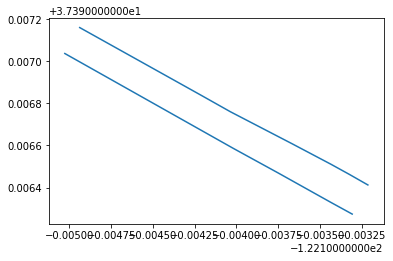

In [149]:
edges.plot()

In [150]:
edges.head()

,osmid,name,highway,maxspeed,oneway,length,lanes,ref,geometry,node_start,node_end
0,632109498,Distel Drive,residential,25 mph,False,17.478,NaN,NaN,None,0,3
1,8952239,Distel Circle,residential,25 mph,False,15.805,NaN,NaN,None,1,2
2,8952239,Distel Circle,residential,25 mph,False,15.805,NaN,NaN,None,2,1
3,"[417227847, 417227863]",West El Camino Real,primary,35 mph,True,174.770,"[3, 4]",CA 82,"LINESTRING (-122.10503 37.39704, -122.10478 37...",2,0
4,632109498,Distel Drive,residential,25 mph,False,17.478,NaN,NaN,None,3,0


In [151]:
edges = edges.dropna(subset=["geometry"]).reset_index(drop=True)
hits = bbox.apply(lambda row: list(edges.sindex.intersection(row)), axis=1)
tmp = pd.DataFrame({
    # index of points table
    "pt_idx": np.repeat(hits.index, hits.apply(len)),
    # ordinal position of line - access via iloc later
    "line_i": np.concatenate(hits.values)
})
# Join back to the lines on line_i; we use reset_index() to 
# give us the ordinal position of each line
tmp = tmp.join(edges.reset_index(drop=True), on="line_i")
# Join back to the original points to get their geometry
# rename the point geometry as "point"
tmp = tmp.join(target_gt_gdf.geometry.rename("point"), on="pt_idx")
# Convert back to a GeoDataFrame, so we can do spatial ops
tmp = gpd.GeoDataFrame(tmp, geometry="geometry", crs=target_gt_gdf.crs)

In [152]:
tmp.head()

,pt_idx,line_i,osmid,name,highway,maxspeed,oneway,length,lanes,ref,geometry,node_start,node_end,point
0,71935,0,"[417227847, 417227863]",West El Camino Real,primary,35 mph,True,174.770,"[3, 4]",CA 82,"LINESTRING (-122.10503 37.39704, -122.10478 37...",2,0,POINT (-122.10351 37.39655)
1,71935,1,"[5018668, 417227868]",West El Camino Real,primary,35 mph,True,174.345,"[3, 4]",CA 82,"LINESTRING (-122.10321 37.39641, -122.10332 37...",3,1,POINT (-122.10351 37.39655)
2,71936,0,"[417227847, 417227863]",West El Camino Real,primary,35 mph,True,174.770,"[3, 4]",CA 82,"LINESTRING (-122.10503 37.39704, -122.10478 37...",2,0,POINT (-122.10369 37.39665)
3,71936,1,"[5018668, 417227868]",West El Camino Real,primary,35 mph,True,174.345,"[3, 4]",CA 82,"LINESTRING (-122.10321 37.39641, -122.10332 37...",3,1,POINT (-122.10369 37.39665)
4,71937,0,"[417227847, 417227863]",West El Camino Real,primary,35 mph,True,174.770,"[3, 4]",CA 82,"LINESTRING (-122.10503 37.39704, -122.10478 37...",2,0,POINT (-122.10388 37.39670)


In [153]:
tmp

,pt_idx,line_i,osmid,name,highway,maxspeed,oneway,length,lanes,ref,geometry,node_start,node_end,point
0,71935,0,"[417227847, 417227863]",West El Camino Real,primary,35 mph,True,174.770,"[3, 4]",CA 82,"LINESTRING (-122.10503 37.39704, -122.10478 37...",2,0,POINT (-122.10351 37.39655)
1,71935,1,"[5018668, 417227868]",West El Camino Real,primary,35 mph,True,174.345,"[3, 4]",CA 82,"LINESTRING (-122.10321 37.39641, -122.10332 37...",3,1,POINT (-122.10351 37.39655)
2,71936,0,"[417227847, 417227863]",West El Camino Real,primary,35 mph,True,174.770,"[3, 4]",CA 82,"LINESTRING (-122.10503 37.39704, -122.10478 37...",2,0,POINT (-122.10369 37.39665)
3,71936,1,"[5018668, 417227868]",West El Camino Real,primary,35 mph,True,174.345,"[3, 4]",CA 82,"LINESTRING (-122.10321 37.39641, -122.10332 37...",3,1,POINT (-122.10369 37.39665)
4,71937,0,"[417227847, 417227863]",West El Camino Real,primary,35 mph,True,174.770,"[3, 4]",CA 82,"LINESTRING (-122.10503 37.39704, -122.10478 37...",2,0,POINT (-122.10388 37.39670)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,74018,1,"[5018668, 417227868]",West El Camino Real,primary,35 mph,True,174.345,"[3, 4]",CA 82,"LINESTRING (-122.10321 37.39641, -122.10332 37...",3,1,POINT (-122.10388 37.39654)
204,74019,0,"[417227847, 417227863]",West El Camino Real,primary,35 mph,True,174.770,"[3, 4]",CA 82,"LINESTRING (-122.10503 37.39704, -122.10478 37...",2,0,POINT (-122.10374 37.39646)
205,74019,1,"[5018668, 417227868]",West El Camino Real,primary,35 mph,True,174.345,"[3, 4]",CA 82,"LINESTRING (-122.10321 37.39641, -122.10332 37...",3,1,POINT (-122.10374 37.39646)
206,74020,0,"[417227847, 417227863]",West El Camino Real,primary,35 mph,True,174.770,"[3, 4]",CA 82,"LINESTRING (-122.10503 37.39704, -122.10478 37...",2,0,POINT (-122.10357 37.39638)


In [154]:
tmp["snap_dist"] = tmp.geometry.distance(gpd.GeoSeries(tmp.point))

# Discard any lines that are greater than tolerance from points
tolerance = 0.0005  
tmp = tmp.loc[tmp.snap_dist <= tolerance]
# Sort on ascending snap distance, so that closest goes to top
tmp = tmp.sort_values(by=["snap_dist"])

# group by the index of the points and take the first, which is the
# closest line 
closest = tmp.groupby("pt_idx").first()
# construct a GeoDataFrame of the closest lines
closest = gpd.GeoDataFrame(closest, geometry="geometry")
closest = closest.drop_duplicates("line_i").reset_index(drop=True)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning:

Geometry is in a geographic CRS. Results from 'distance' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning:

CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: None




<AxesSubplot:>

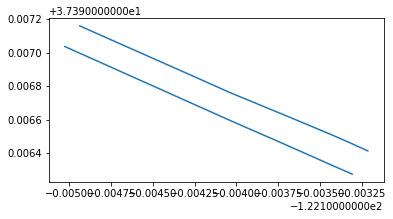

In [155]:
closest.plot()

In [156]:
line_points_list = []
split = 50  # param: number of split in each LineString
for dist in range(0, split, 1):
    dist = dist/split
    line_points = closest["geometry"].interpolate(dist, normalized=True)
    line_points_list.append(line_points)
line_points = pd.concat(line_points_list).reset_index(drop=True)
line_points = line_points.reset_index().rename(columns={0:"geometry"})
line_points["lngDeg"] = line_points["geometry"].x
line_points["latDeg"] = line_points["geometry"].y

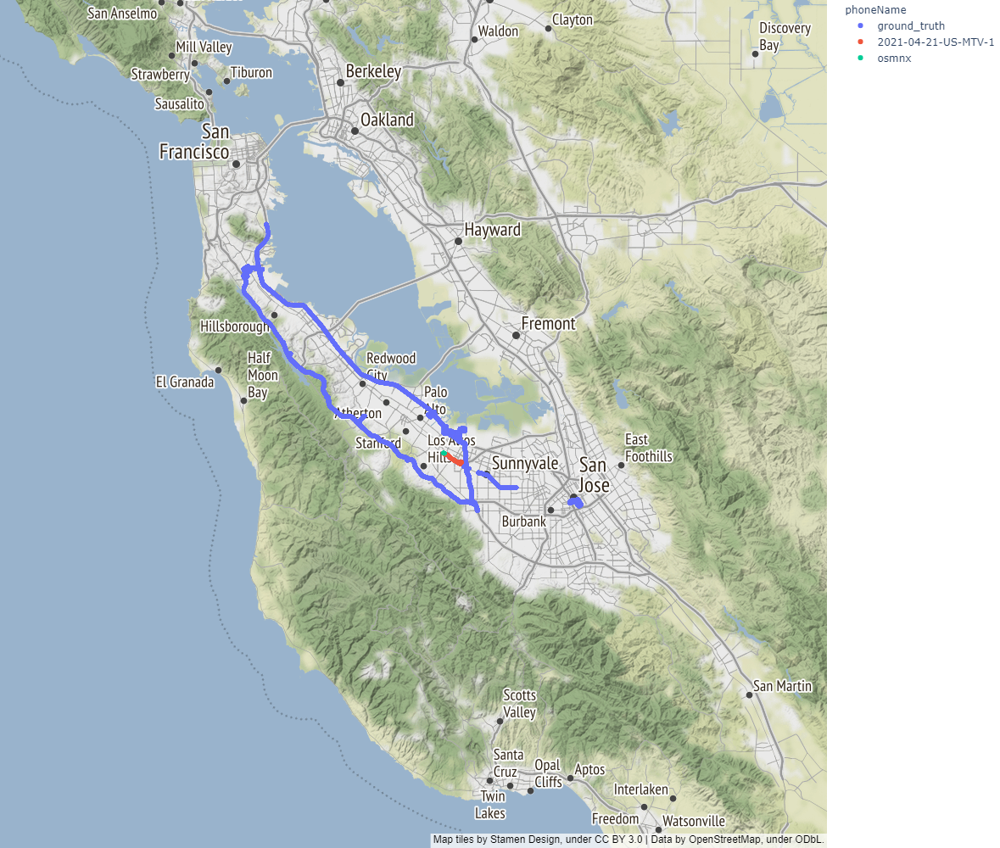

In [158]:
tmp1 = ground_truth.copy()
tmp1['phoneName'] = 'ground_truth'
tmp2 = test.copy()
tmp2['phoneName'] = target
tmp3 = line_points.copy()
tmp3['phoneName'] = 'osmnx'
tmp = pd.concat([tmp1, tmp2, tmp3])
tmp['collectionName'] = 'all'
visualize_collection(tmp, 'all')

In [164]:
line_points[['latDeg', 'lngDeg']].to_csv(f'{INPUT}/prep/osmnx/{target}.csv', index=False)